# <div style="text-align: center"> Machine Learning Classification techniquese </div>

# Introduction

 In this notebook, I am going to work on San Francisco Fire Department(SFFD) calls data. I am going to discuss about step by step process of data extraction, data processing, data transformation and machine learning algorithms to answer my research question. On an avarage everyday approxmately 1000 incident(911) phone calls were made for assistance and help in San Francisco. This calls are related to many emergencies that includes medical help, fire help and rescue help.

There are many variables in the dataset like call time, response time, neighbourhood, alarms, life support and incident types that are used to answer my research question

# Research question

Since there are many phone calls were made, each call is assigned priority which helps the fire station to assess the situation and able to follow the protocol as needed. As per the priority the SFFD dispath the required units. <br>

#### To what extent Can we predict the priority of the call such as Emergency and Non-emergency?
#### Which Machine learning Algorithm predicts most accurately?

In order to answer my question I will be doing data analysis using many columns such as neighbourhood, incident type, unit type. I am also applying few algorithms to get the maximum accuracy in predicting the priority of incident phone call.

# Data Loading and Data Processing

Import the required libraries for data manipulationg and visualization. I have downloaded the data from Google cloud public dataset (https://console.cloud.google.com/marketplace/details/san-francisco-public-data/sffd-service-calls?filter=solution-type:dataset&filter=category:public-safety&id=55c172ad-e222-475b-bb8c-dc5298fd5255). This dataset is updated daily with the new data and as of february 2020 there are more that 5 million records dated calls from 2001 onwards. As my hardware is not able to handle this much huge data I considered data from 2011 onwards which comprises around 2.6 million records and 36 columns.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import altair as alt

In [2]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [3]:
df = pd.read_csv('FireDepartmentDataset.csv')

C:\Users\nithi\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3057: DtypeWarning: Columns (1,19,20,30) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
df.tail()

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_timestamp,entry_timestamp,dispatch_timestamp,response_timestamp,...,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,row_id,latitude,longitude,neighborhood_name,location_geom
2662067,141912698,RC2,14066281,Medical Incident,2014-07-10,2014-07-10,2014-07-10 17:40:22,2014-07-10 17:41:32,2014-07-10 17:43:32,2014-07-10 17:43:53,...,1,RESCUE CAPTAIN,2.0,7,2,141912698-RC2,37.806658,-122.474717,Presidio,POINT(-122.47471662098 37.806658198958)
2662068,153121075,RC2,15119882,Traffic Collision,2015-11-08,2015-11-08,2015-11-08 09:23:59,2015-11-08 09:29:24,2015-11-08 09:29:46,2015-11-08 09:30:35,...,1,RESCUE CAPTAIN,2.0,7,2,153121075-RC2,37.806658,-122.474717,Presidio,POINT(-122.47471662098 37.806658198958)
2662069,190632501,RC2,19026936,Water Rescue,2019-03-04,2019-03-04,2019-03-04 15:43:22,2019-03-04 15:46:02,2019-03-04 15:51:38,2019-03-04 15:51:38,...,1,RESCUE CAPTAIN,14.0,None,2,190632501-RC2,37.806758,-122.446916,Marina,POINT(-122.446916219003 37.806758208558)
2662070,162552099,RC1,16100506,Water Rescue,2016-09-11,2016-09-11,2016-09-11 14:48:13,2016-09-11 14:49:59,2016-09-11 14:51:20,2016-09-11 14:52:29,...,1,RESCUE CAPTAIN,12.0,1,3,162552099-RC1,37.789475,-122.410406,Nob Hill,POINT(-122.410406163763 37.789475099594)
2662071,143032745,RC2,14107190,Water Rescue,2014-10-30,2014-10-30,2014-10-30 16:09:50,2014-10-30 16:10:40,2014-10-30 16:13:02,2014-10-30 16:14:02,...,1,RESCUE CAPTAIN,9.0,7,2,143032745-RC2,37.808977,-122.474610,Presidio,POINT(-122.47460956271 37.808976788801)


I have deleted irrelevant columns from my dataset in order to predict athe outcome more accurately. I have also removed columns with more null values and similar valued columns like on_scene_timestamp, transport_timestamp which has the exact value with seconds different in their timestamp.

In [5]:
df = df.drop(['on_scene_timestamp', 'transport_timestamp', 'hospital_timestamp','call_number','unit_id','incident_number',
         'watch_date','address','original_priority', 'call_type_group','row_id','latitude','longitude','location_geom','available_timestamp'], axis=1)

In [6]:
df_bkp = df

df = df_bkp

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2662072 entries, 0 to 2662071
Data columns (total 21 columns):
call_type                         object
call_date                         object
received_timestamp                object
entry_timestamp                   object
dispatch_timestamp                object
response_timestamp                object
call_final_disposition            object
city                              object
zipcode_of_incident               float64
battalion                         object
station_area                      object
box                               object
priority                          object
final_priority                    int64
als_unit                          bool
number_of_alarms                  int64
unit_type                         object
unit_sequence_in_call_dispatch    float64
fire_prevention_district          object
supervisor_district               object
neighborhood_name                 object
dtypes: bool(1), float64(2),

In [8]:
df["received_timestamp"] = pd.to_datetime(df["received_timestamp"])
df = df.sort_values(by=['received_timestamp'])

In [9]:
df = df.reset_index(drop=True)

In [10]:
df.head()

,call_type,call_date,received_timestamp,entry_timestamp,dispatch_timestamp,response_timestamp,call_final_disposition,city,zipcode_of_incident,battalion,...,box,priority,final_priority,als_unit,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhood_name
0,Medical Incident,2011-01-01,2011-01-01 00:01:08,2011-01-01 00:01:43,2011-01-01 00:38:22,NaN,Other,SF,94102.0,B01,...,1462,2,2,True,1,ENGINE,2.0,1,6,Tenderloin
1,Medical Incident,2011-01-01,2011-01-01 00:01:08,2011-01-01 00:01:43,2011-01-01 00:38:22,2011-01-01 00:39:55,Other,SF,94102.0,B01,...,1462,2,2,True,1,ENGINE,1.0,1,6,Tenderloin
2,Medical Incident,2011-01-01,2011-01-01 00:01:08,2011-01-01 00:01:43,2011-01-01 00:38:22,NaN,Code 2 Transport,SF,94102.0,B01,...,1462,2,2,False,1,PRIVATE,3.0,1,6,Tenderloin
3,Medical Incident,2011-01-01,2011-01-01 00:02:34,2011-01-01 00:02:59,2011-01-01 00:17:12,2011-01-01 00:19:48,Other,SF,94110.0,B02,...,5247,3,3,True,1,ENGINE,4.0,6,8,Mission
4,Medical Incident,2011-01-01,2011-01-01 00:02:34,2011-01-01 00:02:59,2011-01-01 00:17:12,NaN,Other,SF,94110.0,B02,...,5247,3,3,True,1,ENGINE,5.0,6,8,Mission


In order to clean the data I have converted duplicate values in neighbourhood_name column to have proper values. Changed the datatypes of the few columns. Created new columns for better analysis.

In [11]:
c_list = {'SF': 'San Francisco', 'SAN FRANCISCO': 'San Francisco', 'PR': 'Presidio', 'PRESIDIO': 'Presidio', 'HP': 'Hunters Point',
         'DC': 'Daly City','DALY CITY':'Daly City', "TI": 'Treasure Island', 'TREASURE ISLAND': "Treasure Island",'Treasure Isla': "Treasure Island",
          'YB':'Yerba Buena','YERBA BUENA IS': 'Yerba Buena', 'BN': 'Brisbane','FM': 'Fort Mason','FORT MASON': 'Fort Mason','HUNTERS POINT': 'Hunters Point',
         'OAK': 'San Francisco','AI': 'San Francisco'}


In [12]:
df['city'] = df['city'].map(c_list).fillna(df['city'])

In [13]:
df["received_timestamp"] = pd.to_datetime(df["received_timestamp"])

In [14]:
df['receive_hour'] = df['received_timestamp'].dt.hour
df['receive_min'] = df['received_timestamp'].dt.minute
df['receive_sec'] = df['received_timestamp'].dt.second

In [15]:
def time_in_day(receive_hour):
 
    if (receive_hour >= 5) & (receive_hour < 12):
        tid = "morning"
    elif (receive_hour >= 12) & (receive_hour < 17):
        tid = "afternoon"
    elif (receive_hour >= 17) & (receive_hour <= 21):
        tid = "evening"
    else:
        tid = "night"
    
    return tid

In [16]:
df["time_in_day"] = df["receive_hour"].apply(lambda row: time_in_day(row))

# Data Analysis

We are going to analyse the dataset and try to find insights which will help us in predicting the priority of the call

In [17]:
df_time = df.groupby(['time_in_day','call_type']).count()[['call_date']].reset_index()

In [18]:
alt.Chart(df_time).mark_bar().encode(
    alt.X('sum(call_date):Q', title='No. of Calls'),
    alt.Y('time_in_day:N', title='')
    #,color='call_type:N'
)

alt.Chart(...)

From the above graph we can see that most of the calls were made in the afternoon (12pm to 5pm) and least calls were received during night time (10pm to 4am). As everyone starts returning their houses and people close their business in the evenings there were few incidents compared to morning and afternoon where people are busy.

In [19]:
alt.Chart(df_time).mark_bar().encode(
    alt.X('call_type', title='Incident Category'),
    alt.Y('call_date', title='No. of Calls')
   # ,color='call_type:N'
)

alt.Chart(...)

The above plot x-axis represents the type of the incidents and y-axis represents its total count from 2011 january to 2020 february. We can see that half million medical incidents were reported to SFFD. There were very few rescue incidents. After medical incidents, alarms and structure fire incidents comes in 2nd and 3rd most recieved calls.

In [20]:
df_inc = df.groupby(['call_date','neighborhood_name']).count()[['call_type']].reset_index()

In [21]:
selection = alt.selection_multi(fields=['neighborhood_name'], bind='legend')

plot = alt.Chart(df_inc).mark_area().encode(
    alt.X('yearmonth(call_date):T', axis=alt.Axis(domain=False, format='%Y', tickSize=0)),
    alt.Y('sum(call_type):Q', stack='center', axis=None),
    alt.Color('neighborhood_name:N', scale=alt.Scale(scheme='category20b')),
    opacity=alt.condition(selection, alt.value(1), alt.value(0.2))
).add_selection(
    selection
)

In [22]:
plot

alt.Chart(...)

From the above graph we can see that over the years phone calls received by SFFD were increasing. The growth rate of calls over the neigbourhoods are also increasing in the same manner. Lets look little bit deeper in the next graph.

In [23]:
alt.Chart(df_inc).mark_bar().encode(
    alt.X('sum(call_type):Q', title=''),
    alt.Y('neighborhood_name:N', title='Neighborhoods')
)

alt.Chart(...)

In the above graph x-axis represents count of the calls and y-axis represents neighbourhoods. From the above plot we can see that most phone calls were made to SFFD from Tenderlion neighbourhood with more that 350 thousand phone calls followed by 'South of Market' and 'Mission'. Least calls were made from 'Lincoln park','McLaren park' and 'Seacliff'.

In [24]:
df["zipcode_of_incident"] = pd.to_numeric(df["zipcode_of_incident"], errors='ignore', downcast='integer')

In [25]:
df = df.drop(['received_timestamp','entry_timestamp','dispatch_timestamp','response_timestamp','call_date'], axis = 1)

In [26]:
df['unit_type'] = pd.Categorical(df['unit_type']).codes
df['call_type'] = pd.Categorical(df['call_type']).codes
df['priority'] = pd.Categorical(df['priority']).codes
df['time_in_day'] = pd.Categorical(df['time_in_day']).codes
df['call_final_disposition'] = pd.Categorical(df['call_final_disposition']).codes
df['city'] = pd.Categorical(df['city']).codes
df['battalion'] = pd.Categorical(df['battalion']).codes
df['station_area'] = pd.Categorical(df['station_area']).codes
df['box'] = pd.Categorical(df['box']).codes
df['als_unit'] = pd.Categorical(df['als_unit']).codes
df['fire_prevention_district'] = pd.Categorical(df['fire_prevention_district']).codes
df['supervisor_district'] = pd.Categorical(df['supervisor_district']).codes
df['neighborhood_name'] = pd.Categorical(df['neighborhood_name']).codes

In [27]:
#df['final_priority'].unique()
df["final_priority"].replace({2: 1, 3: 0}, inplace=True)

In [28]:
df['battalion'] = pd.to_numeric(df['battalion'])

In [29]:
df['unit_sequence_in_call_dispatch']= df['unit_sequence_in_call_dispatch'].replace('.',"")

In [30]:
df = df.dropna()

In [31]:
df.head()

,call_type,call_final_disposition,city,zipcode_of_incident,battalion,station_area,box,priority,final_priority,als_unit,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhood_name,receive_hour,receive_min,receive_sec,time_in_day
0,17,11,6,94102.0,2,2,2702,1,1,1,1,2,2.0,0,18,36,0,1,8,3
1,17,11,6,94102.0,2,2,361,1,1,1,1,2,1.0,0,18,36,0,1,8,3
2,17,3,6,94102.0,2,2,361,1,1,0,1,5,3.0,0,18,36,0,1,8,3
3,17,11,6,94110.0,3,6,4263,2,0,1,1,2,4.0,6,20,18,0,2,34,3
4,17,11,6,94110.0,3,6,1110,2,0,1,1,2,5.0,6,20,18,0,2,34,3


In [32]:
df_box = df.loc[:, ~df.columns.isin(['zipcode_of_incident','final_priority','box'])]

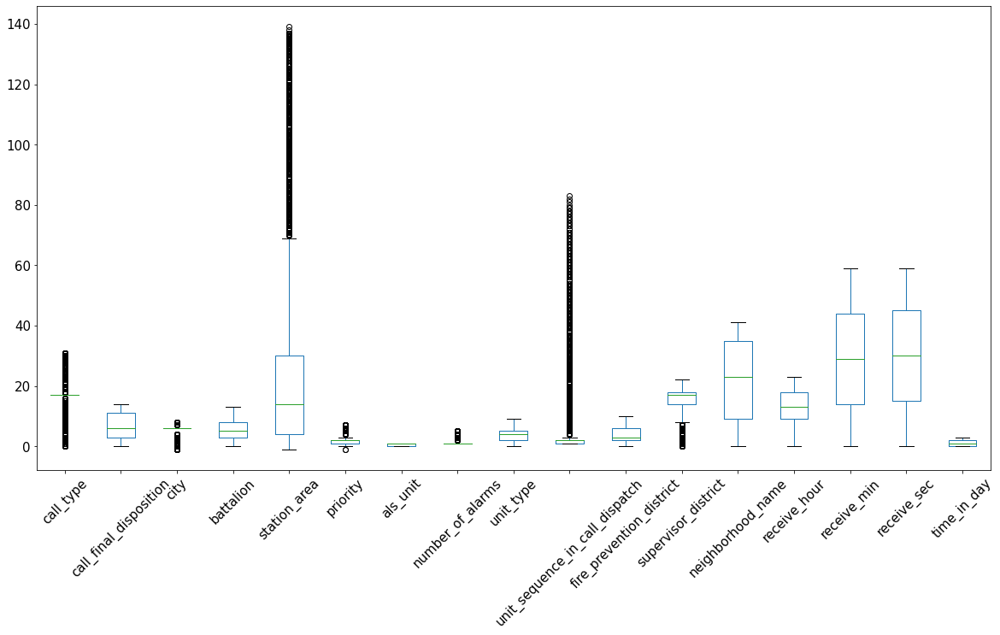

In [33]:
df_box.boxplot(grid=False, rot=45, fontsize=15, figsize=(20,10))

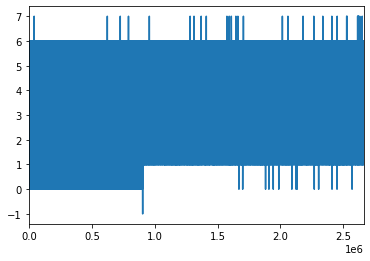

In [34]:
df['priority'].plot()

I am using correlation heat map to get the colinearity between the dependent and indipendent variables in order to reduce noise in the accuracy.

In [35]:
corr = df.corr()

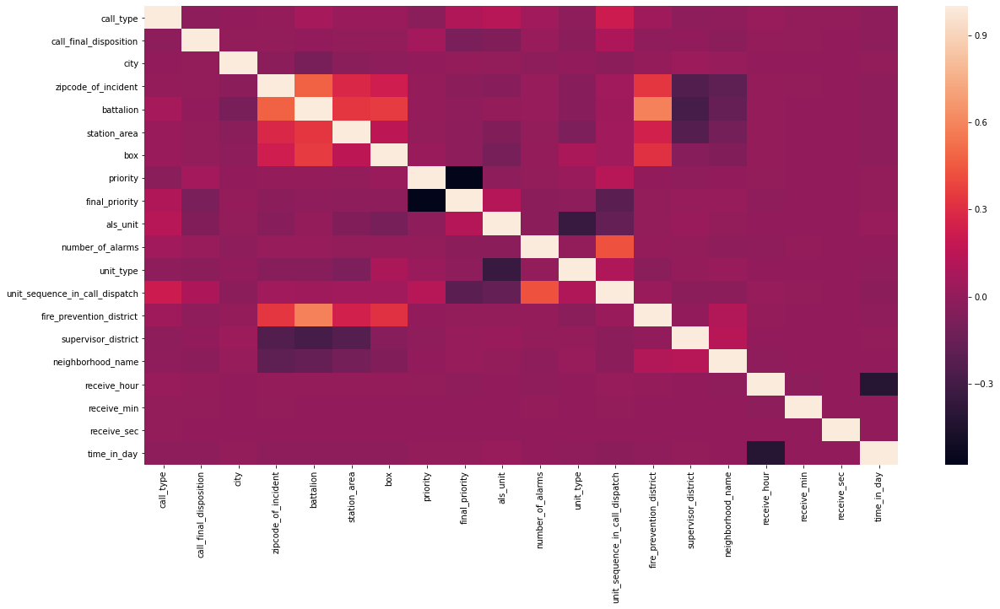

In [36]:
plt.subplots(figsize=(20,10))
sns.heatmap(corr)

In [37]:
df.isnull().sum()

call_type                         0
call_final_disposition            0
city                              0
zipcode_of_incident               0
battalion                         0
station_area                      0
box                               0
priority                          0
final_priority                    0
als_unit                          0
number_of_alarms                  0
unit_type                         0
unit_sequence_in_call_dispatch    0
fire_prevention_district          0
supervisor_district               0
neighborhood_name                 0
receive_hour                      0
receive_min                       0
receive_sec                       0
time_in_day                       0
dtype: int64

## classifiers

At first i tried regession algorithms and tried applying linear regression to the dataset in which i got 33 percent accuracy. I found that it is not applicable to this type of predictions as i am getting float values but we need to classify the call, this means we need integers. 

I am trying to use classifier algorithms inorder to predict the priority of the phone call. For that we need to split the data into train and test data. Here i am splitting the data into 33 percent test and 64 percent train data. And for classifiers F1-score is more important than the the total accuracy. In the priority column 1 represents Emergency and 0 represents non-emergency.

In [46]:
import numpy as np
from sklearn.model_selection import train_test_split,GridSearchCV
from matplotlib import pyplot

In [39]:
X = df.loc[:, ~df.columns.isin(['priority','final_priority'])]
y = df.loc[:, df.columns == 'final_priority']

In [40]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=101)

In [41]:
from sklearn.metrics import accuracy_score, f1_score,precision_recall_curve,classification_report,confusion_matrix,roc_curve,roc_auc_score, auc
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier

In [42]:
log_cols=["Classifier","accuracy","f1 score","AUC"]
log = pd.DataFrame(columns=log_cols)

### Decision Trees

Decision trees are one of the widely used machine learning alorithms for both regression and also for classification. These can handle both categorical as well as numerical variables. In this dataset is divided into subsets under the each variable forming tree structure which helps to make decisions. It involves decision nodes which are independent variables and leaf nodes which are dependent variables. Top node will make the decision to which bottom node the data should be sent and this is how it will predict the value.

In [43]:
DT = DecisionTreeClassifier()
DT.fit(X_train, y_train.values.ravel())
train_predictions = DT.predict(X_test)

In [44]:
acc = round(accuracy_score(y_test, train_predictions),2)
#prfs = precision_recall_fscore_support(y_test['final_priority'], train_predictions, average=None)
f1s = round(f1_score(y_test, train_predictions, average='macro'),2)
# predict probabilities
lr_probs = DT.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# predict class values
yhat = DT.predict(X_test)
lr_precision, lr_recall, _ = precision_recall_curve(y_test, lr_probs)
lr_f1, lr_auc = f1_score(y_test, yhat), auc(lr_recall, lr_precision)
# plot the precision-recall curves
no_skill = len(y_test[y_test==1]) / len(y_test)
#log_entry = pd.DataFrame([["Decision Tree",prfs[0][0]*100,prfs[0][1]*100,prfs[1][0]*100,prfs[1][1]*100,prfs[2][0]*100,prfs[2][1]*100,acc*100]], columns=log_cols)
log_entry = pd.DataFrame([["Decision Tree",acc*100,f1s*100,lr_auc*100]], columns=log_cols)
log = log.append(log_entry)

DecisionTree: f1=0.511 auc=0.579


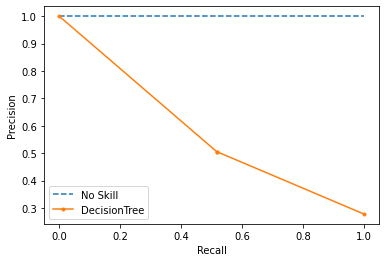

In [47]:
# summarize scores
print('DecisionTree: f1=%.3f auc=%.3f' % (lr_f1, lr_auc))
pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
pyplot.plot(lr_recall, lr_precision, marker='.', label='DecisionTree')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

In [48]:
pd.DataFrame(DT.feature_importances_,
             index = X_train.columns, columns=['importance']).sort_values('importance',ascending=False)

,importance
receive_min,0.158566
receive_sec,0.157206
call_type,0.143473
box,0.132175
unit_type,0.094232
receive_hour,0.092497
unit_sequence_in_call_dispatch,0.058371
call_final_disposition,0.028320
station_area,0.026431
neighborhood_name,0.022408


In [49]:
print(classification_report(y_test,train_predictions))

              precision    recall  f1-score   support

           0       0.81      0.80      0.81    632423
           1       0.51      0.52      0.51    244062

    accuracy                           0.72    876485
   macro avg       0.66      0.66      0.66    876485
weighted avg       0.73      0.72      0.73    876485



In [50]:
print(confusion_matrix(y_test,train_predictions))

[[509003 123420]
 [117812 126250]]


From the classification report we can see that the accuracy of the model is 72% but the precision and recall plays key role in classification models.presicion for 0 is 51% and for 1 is 81%, recall for 0 is 52% and for 1 is 80%. Means it is able to predict 0 more accurately than 1. I Think this is because of lot of 0 values in the dataset. Also Receive_min and receive_sec are providing more weightage in the algorithms accuracy. Overall accuracy of the model is 72% with AUC 0.57.

### Random Forest

Random forest is also one of the most used technique in machine learning. It can be used for both classification and regression  but it is mainly used for classification purpose. It is similar to decision trees but in this it selects numerous sample data from the dataset and apply decision tree algorithm on each sample dataset and gets the prediction from them. Then voting will be performed on each predicted result and the most voted result will be your predicted value. Theoritically it will give better results than decision trees as it reduces the over-fitting by averaging the result.

In [51]:
RF = RandomForestClassifier()
RF.fit(X_train, y_train.values.ravel())
train_predictions = RF.predict(X_test)

In [52]:
acc = round(accuracy_score(y_test, train_predictions),2)
f1s = round(f1_score(y_test, train_predictions, average='macro'),2)
# predict probabilities
lr_probs = RF.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# predict class values
yhat = RF.predict(X_test)
lr_precision, lr_recall, _ = precision_recall_curve(y_test, lr_probs)
lr_f1, lr_auc = f1_score(y_test, yhat), auc(lr_recall, lr_precision)
# plot the precision-recall curves
no_skill = len(y_test[y_test==1]) / len(y_test)
log_entry = pd.DataFrame([["RandomForest",acc*100,f1s*100,lr_auc*100]], columns=log_cols)
log = log.append(log_entry)

RandomForest: f1=0.567 auc=0.641


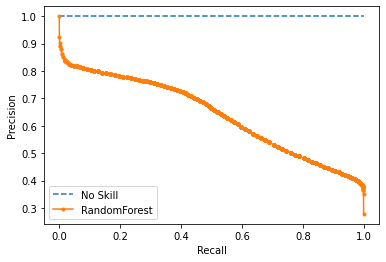

In [53]:
# summarize scores
print('RandomForest: f1=%.3f auc=%.3f' % (lr_f1, lr_auc))
pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
pyplot.plot(lr_recall, lr_precision, marker='.', label='RandomForest')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

In [54]:
pd.DataFrame(RF.feature_importances_,
             index = X_train.columns, columns=['importance']).sort_values('importance',ascending=False)

,importance
receive_min,0.154419
receive_sec,0.154036
box,0.127802
unit_type,0.103068
receive_hour,0.087497
unit_sequence_in_call_dispatch,0.085372
call_type,0.074480
call_final_disposition,0.067975
station_area,0.029010
neighborhood_name,0.022569


In [55]:
print(classification_report(y_test,train_predictions))

              precision    recall  f1-score   support

           0       0.82      0.91      0.86    632423
           1       0.67      0.49      0.57    244062

    accuracy                           0.79    876485
   macro avg       0.75      0.70      0.72    876485
weighted avg       0.78      0.79      0.78    876485



In [56]:
print(confusion_matrix(y_test,train_predictions))

[[574365  58058]
 [124375 119687]]


From the classification report we can see that the total accuracy of the model is 79% .precision for 1 is 67% and for 0 is 82%, recall for 1 is 49% and for 0 is 91%. Means it is able to predict 3 more accurately than 2. As we can see this model predicts the values better than the decision trees. Also Receive_min and receive_sec are providing more weightage in the algorithms accuracy. Overall accuracy of the model is 79% with AUC 0.64.

### Ada Boost

Generally boosting means it is a method that creates strong classifier from many weak classifiers. Adaboost is first successful boosting technique. AdaBoost is best used to boost the performance of decision trees on binary classification problems.Only binary classification problems are supported. While training the data, take the weak classifier weighted sample and the value prediction will be done.It will be either +1 or -1 as it is binary classification. Misclassification rate is calculated for each trained model.<br>

E = (correct-N)/N <br>

where E is Misclassification rate,correct are the instances predicted correctly, N is total instances predicted.

Using this model is trained and for each model a stage value is calculated. stage value is a weighting value for predictions that model makes.<br>

S = ln((1-E) / E)

Where S is the stage value used to weight predictions from the model, ln() is the natural logarithm and E is the misclassification error for the model. Effect of stage value is that the more accurate models have more weight or contribution to the final prediction.The training weights are updated giving more weight to incorrectly predicted instances, and less weight to correctly predicted instances.

Then weighted sum is calculated using S value. <br>

w = w * exp(S * terror)
terror = 0 if(y == p), otherwise 1

Where w is the weight for a specific training instance, exp() is the numerical constant e or Euler’s number raised to a power, S is the misclassification rate for the weak classifier and terror is the error the weak classifier made predicting the output variable for the training instance, y is the output variable for the training instance and p is the prediction from the weak learner.

This process will be done based of user parameter for number of runs or untill no improvements can be done. Once it is done you will have weak classifiers with stage values which are used for predicting the predictors.

How it works is from the dataset weak classifiers will predict the values either +1 or -1 then stage values are calculated for each classifier. Then we will calculate the weighted sumfor these predictions. if the result of the sum is negative then the final value will be -1 and the same way if it is positive then the final value predicted will be +1.

In [57]:
ADA = AdaBoostClassifier()
ADA.fit(X_train, y_train.values.ravel())
train_predictions = ADA.predict(X_test)

In [58]:
acc = round(accuracy_score(y_test, train_predictions),2)
f1s = round(f1_score(y_test, train_predictions, average='macro'),2)
# predict probabilities
lr_probs = ADA.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# predict class values
yhat = ADA.predict(X_test)
lr_precision, lr_recall, _ = precision_recall_curve(y_test, lr_probs)
lr_f1, lr_auc = f1_score(y_test, yhat), auc(lr_recall, lr_precision)
# plot the precision-recall curves
no_skill = len(y_test[y_test==1]) / len(y_test)
log_entry = pd.DataFrame([["AdaBoost",acc*100,f1s*100,lr_auc*100]], columns=log_cols)
log = log.append(log_entry)


AdaBoost: f1=0.564 auc=0.633


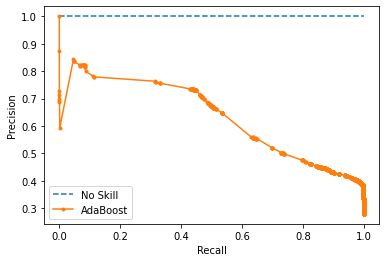

In [59]:

# summarize scores
print('AdaBoost: f1=%.3f auc=%.3f' % (lr_f1, lr_auc))
pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
pyplot.plot(lr_recall, lr_precision, marker='.', label='AdaBoost')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

In [60]:
pd.DataFrame(ADA.feature_importances_,
             index = X_train.columns, columns=['importance']).sort_values('importance',ascending=False)

,importance
call_type,0.50
call_final_disposition,0.24
unit_sequence_in_call_dispatch,0.12
unit_type,0.10
zipcode_of_incident,0.02
fire_prevention_district,0.02
battalion,0.00
station_area,0.00
box,0.00
als_unit,0.00


In [61]:
print(classification_report(y_test,train_predictions))

              precision    recall  f1-score   support

           0       0.82      0.92      0.87    632423
           1       0.71      0.47      0.56    244062

    accuracy                           0.80    876485
   macro avg       0.76      0.70      0.72    876485
weighted avg       0.79      0.80      0.78    876485



In [62]:
print(confusion_matrix(y_test,train_predictions))

[[584684  47739]
 [129418 114644]]


From the classification report we can see that the total accuracy of the model is 80% .precision of 1 is 71% and for 0 is 82%, recall for 1 is 47% and for 0 is 92%. Means it is able to predict 1 more accurately than 0. As we can see this model predicts the values almost equal to random forst model. Also call_type alone is providing more weightage in the algorithms accuracy. Overall accuracy of the model is 80% with AUC 0.63.

### Gradient Boosting

Gradient boosting is one of the prowerful method for building models. It is similar to Adaboost as it is built on adaboost's statistical framework. This technique involes three steps that is loss function, weak learner and additive model. When doing loss function for classification we use logarithmic loss. For weak learner decision trees are used in gradient boosting. In this the output from the nodes will be real values and it is added to make the prediction that is same as adaboost. Here trees are constructed in a manner where it gives best points or lease loss. Unlike adaboost this can be used for larger trees upto 8 levels. 

Gradient descent procedude is used to minimize the loss when adding the trees. Trees are added one at a time without removing the trees in the model. In this we will be added new trees to reduce the loss. the new output of the new tree is added to the exising tree untill the log is reduced to acceptable level.

In [63]:
GB = GradientBoostingClassifier()
GB.fit(X_train, y_train.values.ravel())
train_predictions = GB.predict(X_test)

In [64]:
acc = round(accuracy_score(y_test, train_predictions),2)
f1s = round(f1_score(y_test, train_predictions, average='macro'),2)
# predict probabilities
lr_probs = GB.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# predict class values
yhat = GB.predict(X_test)
lr_precision, lr_recall, _ = precision_recall_curve(y_test, lr_probs)
lr_f1, lr_auc = f1_score(y_test, yhat), auc(lr_recall, lr_precision)
# plot the precision-recall curves
no_skill = len(y_test[y_test==1]) / len(y_test)
log_entry = pd.DataFrame([["GradientBoosting",acc*100,f1s*100,lr_auc*100]], columns=log_cols)
log = log.append(log_entry)

GradientBoosting: f1=0.561 auc=0.654


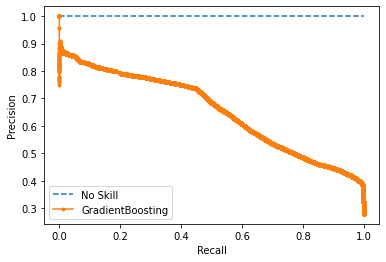

In [65]:
# summarize scores
print('GradientBoosting: f1=%.3f auc=%.3f' % (lr_f1, lr_auc))
pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
pyplot.plot(lr_recall, lr_precision, marker='.', label='GradientBoosting')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

In [66]:
pd.DataFrame(GB.feature_importances_,
             index = X_train.columns, columns=['importance']).sort_values('importance',ascending=False)

,importance
unit_type,0.355290
call_type,0.271264
unit_sequence_in_call_dispatch,0.258749
call_final_disposition,0.106764
zipcode_of_incident,0.002004
battalion,0.001549
als_unit,0.001113
fire_prevention_district,0.001067
city,0.000647
box,0.000453


In [67]:
print(classification_report(y_test,train_predictions))

              precision    recall  f1-score   support

           0       0.82      0.94      0.87    632423
           1       0.73      0.45      0.56    244062

    accuracy                           0.80    876485
   macro avg       0.77      0.69      0.72    876485
weighted avg       0.79      0.80      0.79    876485



In [68]:
print(confusion_matrix(y_test,train_predictions))

[[592016  40407]
 [133293 110769]]


From the classification report we can see that the total accuracy of the model is 80% .precision of 1 is 73% and for 0 is 82%, recall for 1 is 45% and for 0 is 94%. Means it is able to predict 3 more accurately than 2. As we can see this model predicts the values exactly equal to adaboost as my dataset pridictor is only 1 level. Also Unit_type and call_type are providing more weightage in the algorithms accuracy. Overall accuracy of the model is 80% with AUC 0.65.

### KNN

K nearest  neighbour is a very simple and easy to implement algorithm. it is used for solving both regression and classification problems. It works on a principle that similar things are nearer to each other. Here K plays important role. When a new datapoint comes based on the k value the new pointt will be classified. For example assume k is 3 when the new datapoint comes based on Euclidean, Manhattan or Hamming distance we select 3 points near to it. Using those 3 points we will assign the new datapoint to the class with majority votes.

In [69]:
KNN = KNeighborsClassifier(3)
KNN.fit(X_train, y_train.values.ravel())
train_predictions = KNN.predict(X_test)

In [70]:
acc = round(accuracy_score(y_test, train_predictions),2)
f1s = round(f1_score(y_test, train_predictions, average='macro'),2)
# predict probabilities
lr_probs = KNN.predict_proba(X_test)
# keep probabilities for the positive outcome only
lr_probs = lr_probs[:, 1]
# predict class values
yhat = KNN.predict(X_test)
lr_precision, lr_recall, _ = precision_recall_curve(y_test, lr_probs)
lr_f1, lr_auc = f1_score(y_test, yhat), auc(lr_recall, lr_precision)
# plot the precision-recall curves
no_skill = len(y_test[y_test==1]) / len(y_test)
log_entry = pd.DataFrame([["KNN",acc*100,f1s*100,lr_auc*100]], columns=log_cols)
log = log.append(log_entry)

KNN: f1=0.463 auc=0.506


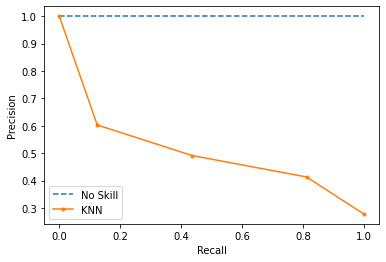

In [71]:
# summarize scores
print('KNN: f1=%.3f auc=%.3f' % (lr_f1, lr_auc))
pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
pyplot.plot(lr_recall, lr_precision, marker='.', label='KNN')
# axis labels
pyplot.xlabel('Recall')
pyplot.ylabel('Precision')
# show the legend
pyplot.legend()
# show the plot
pyplot.show()

In [72]:
print(classification_report(y_test,train_predictions))

              precision    recall  f1-score   support

           0       0.79      0.83      0.81    632423
           1       0.49      0.44      0.46    244062

    accuracy                           0.72    876485
   macro avg       0.64      0.63      0.64    876485
weighted avg       0.71      0.72      0.71    876485



In [73]:
print(confusion_matrix(y_test,train_predictions))

[[522045 110378]
 [137414 106648]]


From the classification report we can see that the total accuracy of the model is 72% with AUC 0.5.precision of 1 is 49% and for 0 is 79%, recall for 1 is 44% and for 0 is 83%. Means it is able to predict 0 more accurately than 1. For my data it it not better model as all the f1-socres and accurracy is very less. Also Receive_min and receive_sec are providing more weightage in the algorithms accuracy. 

# Scoring

For scoring of the model we have considered Precision-recall AUC curve, Classification report and feature importance of the data. Main reason for considering Precision-recall AUC curve is because the dataset has imbalance classes. Classification report provides all the precision, recall and accuracy scores, these are used for considering which model we want to use. Feature importance can be taken and see which columns are significant for the algorithm, using this we can do feature selection.

In [74]:
log

,Classifier,accuracy,f1 score,AUC
0,Decision Tree,72.0,66.0,57.871949
0,RandomForest,79.0,72.0,64.072066
0,AdaBoost,80.0,72.0,63.280129
0,GradientBoosting,80.0,72.0,65.360530
0,KNN,72.0,64.0,50.558689


The above table has the scores of each classifier and we are using f1 score macro avg into consideration. we can compare this to see which model is better fit for our dataset.

In [75]:
log_rep = pd.melt(log, id_vars=['Classifier'], value_vars=['accuracy','f1 score','AUC'])

In [76]:
alt.Chart(log_rep).mark_line().encode(
    y='Classifier:O',
    x='value:Q',
    color = 'variable:N'
)

alt.Chart(...)

The above graph is the pictoral representation of the scores table provided above the graph for better understanding. We can see that Adaboost, GradientBoosting and random forst are equally better from the algorithms we choose, among these three GradientBoosting is slightly better. Hence, GradientBoosting is better fit for our algorithms.

# Findings

1. Majority of the algorithms I have selected use decision trees in their framework and decision trees are widely used technique for solving classification problems.
2. We should always try to select equal number of data in each class inorder to get high accuracy as you can see in my model since 3 values are more the model is trained to predict 3 value most of the time
3. Adaboost will be used only for single split classification. if you have more than 1 split then we can use gradient boosting.
4. In classification always try to have all the f1-scores of the classification types closed to 1 and it should be equally balanced.
5. For an imbalances class dataset mostly we use precision-recall curve  

# Conclusion

We can see that we are able to predict the priority of the SFFD phonecall but only with maximum of 80 percent accuracy. In this we are using macro average f1 score and acheived 72%. We can still improve the accuracy of precision and recall by using sampling techniques. Also we can conclude that boosing algorithms work well than normal techniques and these boosting algorithms use mostly decision trees in their framework. We can also see that Majority of the incidents were made during afternoons and highest incidents are from tenterlion neighbourhood. Most calls received by SFFD are all related to medical incidents than fire and rescue operations. Over the years incidents keeps on increasing, this is likely because of the population and industry growth.

If we can get the population of the area we can perform better analysis and we can provide the areas which are needed fire stations and what time of equipment is needed in it like, this area is needed more medical personnel than fire men. This dataset has still more potential and there is more we can do with this in future provided having better hardware for running large data.